In [1]:
!ls -l

total 192976
-rw-rw-r-- 1 onat onat    31004 Mär 13 11:54 analyze_10mins_orderbook_data.ipynb
-rw-rw-r-- 1 onat onat    31974 Mär 13 11:54 Cargo.lock
-rw-rw-r-- 1 onat onat      457 Mär 13 11:54 Cargo.toml
-rw-rw-r-- 1 onat onat  4007544 Mär 13 11:54 ingested_124.json
-rw-rw-r-- 1 onat onat  5355322 Mär 13 17:23 ingested_207.json
-rw-rw-r-- 1 onat onat  6230132 Mär 13 11:54 ingested_235.json
-rw-rw-r-- 1 onat onat  4795473 Mär 13 11:54 ingested_236.json
-rw-rw-r-- 1 onat onat 32577601 Mär 13 11:54 ingested_888.json
-rw-rw-r-- 1 onat onat 43683364 Mär 13 19:09 Plotter.ipynb
drwxrwxr-x 2 onat onat     4096 Mär 13 19:16 src
drwxrwxr-x 3 onat onat     4096 Mär 13 11:54 target
-rw-rw-r-- 1 onat onat 49545035 Mär 13 18:05 test_1_1420.json
-rw-rw-r-- 1 onat onat 51305402 Mär 13 19:37 test_1_1531.json
-rw-rw-r-- 1 onat onat      617 Mär 13 16:29 Untitled.ipynb


In [152]:
import pandas as pd
import numpy as np

def cancel_outliers(df):
    """
    Removes rows where 'a' or 'b' is empty (NaN, empty lists, empty sets, empty dicts, or empty strings).
    
    Parameters:
        df (pd.DataFrame): The input DataFrame.

    Returns:
        pd.DataFrame: Cleaned DataFrame with only valid rows.
    """
    def is_invalid(value):
        """Checks if a value is missing or empty."""
        if value is None:  # Check for None
            return True
        if isinstance(value, (np.ndarray, pd.Series)):  # Handle arrays and Series
            return np.any(pd.isna(value))  # Check if any element is NaN
        if isinstance(value, (list, set, dict, tuple)) and len(value) == 0:  # Check for empty structures
            return True
        if isinstance(value, str) and not value:  # Check for empty strings
            return True
        return pd.isna(value)  # Check for NaN in scalar values

    # Remove rows where 'a' or 'b' is invalid
    df_cleaned = df[~df['a'].apply(is_invalid) & ~df['b'].apply(is_invalid)]

    # Reset index
    return df_cleaned.reset_index(drop=True)

# Example Usage:
# df = cancel_outliers(df)

               E            U  \
0  1741890050214  64082151728   
1  1741890050314  64082151742   
2  1741890050414  64082151754   
3  1741890050514  64082151760   
4  1741890050614  64082151766   

                                                   a  \
0  [[80665.64000000, 3.51852000], [80673.02000000...   
1  [[80665.64000000, 3.54556000], [80671.51000000...   
2  [[80665.64000000, 3.54491000], [80681.25000000...   
3  [[80681.24000000, 0.39447000], [80681.26000000...   
4  [[80665.64000000, 3.54383000], [80676.41000000...   

                                                   b            e  \
0  [[80665.63000000, 1.88039000], [80655.67000000...  depthUpdate   
1  [[80665.63000000, 0.98059000], [80665.62000000...  depthUpdate   
2  [[80659.80000000, 0.12401000], [72599.00000000...  depthUpdate   
3  [[80575.21000000, 0.54407000], [80502.26000000...  depthUpdate   
4  [[80665.63000000, 1.93591000], [80665.62000000...  depthUpdate   

                                            featu

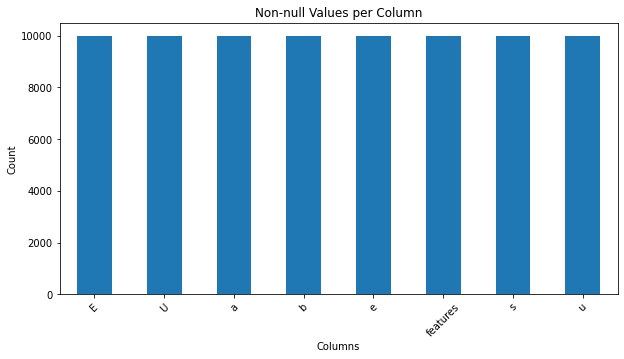

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

# Load JSON file into a DataFrame
file_path = "test_1_1531.json"  # Replace with your actual JSON file path
df = pd.read_json(file_path)

#df = cancel_outliers(df)

# Display the first few rows
print(df.head())

# Visualize the number of non-null values per column
df.notnull().sum().plot(kind='bar', figsize=(10,5), title="Non-null Values per Column")
plt.xlabel("Columns")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()


In [9]:
df.columns

Index(['E', 'U', 'a', 'b', 'e', 'features', 's', 'u'], dtype='object')

In [10]:
df['a'];df['b']

0       [[80665.63000000, 1.88039000], [80655.67000000...
1       [[80665.63000000, 0.98059000], [80665.62000000...
2       [[80659.80000000, 0.12401000], [72599.00000000...
3       [[80575.21000000, 0.54407000], [80502.26000000...
4       [[80665.63000000, 1.93591000], [80665.62000000...
                              ...                        
9995    [[80832.30000000, 4.62374000], [80832.29000000...
9996    [[80832.30000000, 6.94535000], [80832.29000000...
9997    [[80832.30000000, 7.54665000], [80832.29000000...
9998    [[80832.30000000, 8.10525000], [80831.73000000...
9999    [[80832.30000000, 7.48644000], [80831.20000000...
Name: b, Length: 10000, dtype: object

In [11]:
df.features[0]

{'autocorrelation_mid_price': 0.0,
 'best_ask': 80665.64,
 'best_bid': 80665.63,
 'depth_at_top_5': 5.41905,
 'mid_price': 80665.63500000001,
 'mid_price_change': 0.0,
 'order_book_slope': 8.67000000000553,
 'price_weighted_volume_imbalance': -121727.79206309991,
 'rolling_mean_mid_price': 80665.63500000001,
 'rolling_std_mid_price': 0.0,
 'spread': 0.009999999994761,
 'timestamp': 1741890050214,
 'total_ask_volume': 3.52858,
 'total_bid_volume': 2.0196,
 'volume_imbalance': 0.57235488496789,
 'weighted_mid_price': 80665.63348290675}

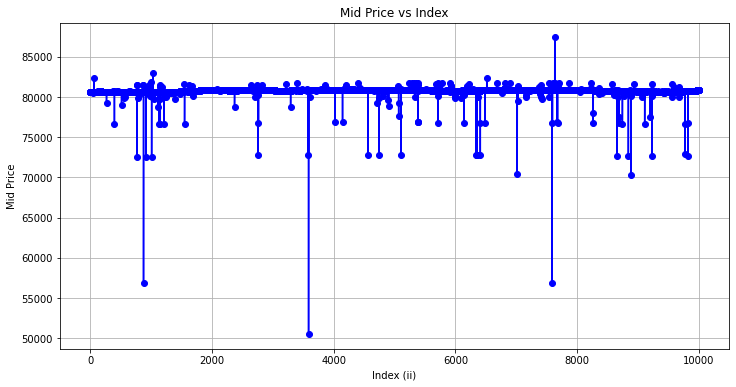

In [12]:
import matplotlib.pyplot as plt

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['mid_price'] for ii in range(len(df))]

# Plot
plt.figure(figsize=(12, 6))
plt.plot(range(len(df)), mid_price_values, marker='o', linestyle='-', color='b')
plt.xlabel("Index (ii)")
plt.ylabel("Mid Price")
plt.title("Mid Price vs Index")
plt.grid(True)
plt.show()

In [13]:
import plotly.graph_objects as go

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['mid_price'] for ii in range(len(df))]

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=list(range(len(mid_price_values))),
    y=mid_price_values,
    mode='lines+markers',
    name='Mid Price'
))

# Update layout for better visualization
fig.update_layout(
    title="Interactive Mid Price Plot",
    xaxis_title="Index (ii)",
    yaxis_title="Mid Price",
    hovermode="x",
)

# Show interactive plot
fig.show()

In [14]:
import plotly.graph_objects as go

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['mid_price_change'] for ii in range(len(df))]

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=list(range(len(mid_price_values))),
    y=mid_price_values,
    mode='lines+markers',
    name='Mid Price'
))

# Update layout for better visualization
fig.update_layout(

    hovermode="x",
)

# Show interactive plot
fig.show()

In [15]:
import plotly.graph_objects as go

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['order_book_slope'] for ii in range(len(df))]

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=list(range(len(mid_price_values))),
    y=mid_price_values,
    mode='lines+markers',
    name='Mid Price'
))

# Update layout for better visualization
fig.update_layout(

    hovermode="x",
)

# Show interactive plot
fig.show()

In [16]:
import plotly.graph_objects as go

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['price_weighted_volume_imbalance'] for ii in range(len(df))]

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=list(range(len(mid_price_values))),
    y=mid_price_values,
    mode='lines+markers',
    name='Mid Price'
))

# Update layout for better visualization
fig.update_layout(

    hovermode="x",
)

# Show interactive plot
fig.show()

In [17]:
import plotly.graph_objects as go

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['spread'] for ii in range(len(df))]

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=list(range(len(mid_price_values))),
    y=mid_price_values,
    mode='lines+markers',
    name='Mid Price'
))

# Update layout for better visualization
fig.update_layout(

    hovermode="x",
)

# Show interactive plot
fig.show()

In [18]:
import plotly.graph_objects as go

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['timestamp'] for ii in range(len(df))]

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=list(range(len(mid_price_values))),
    y=mid_price_values,
    mode='lines+markers',
    name='Mid Price'
))

# Update layout for better visualization
fig.update_layout(

    hovermode="x",
)

# Show interactive plot
fig.show()

In [19]:
import plotly.graph_objects as go

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['volume_imbalance'] for ii in range(len(df))]

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=list(range(len(mid_price_values))),
    y=mid_price_values,
    mode='lines+markers',
    name='Mid Price'
))

# Update layout for better visualization
fig.update_layout(
    hovermode="x",
)

# Show interactive plot
fig.show()

In [20]:
import plotly.graph_objects as go

# Extract 'mid_price' values from all rows
mid_price_values = [df.features[ii]['weighted_mid_price'] for ii in range(len(df))]

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=list(range(len(mid_price_values))),
    y=mid_price_values,
    mode='lines+markers',
    name='Mid Price'
))

# Update layout for better visualization
fig.update_layout(

    hovermode="x",
)

# Show interactive plot
fig.show()